> __**** Projet : Améliorez le produit IA de votre start-up ****__

__* Traitement de texte *__

In [10]:
import numpy as np
import pandas as pd
import os
import json
import timeit

In [11]:
import nltk
import urllib
from nltk.corpus import stopwords 
pd.options.plotting.backend = "plotly"


# CHARGEMENT DES FICHIERS

Le fichier texte : yelp_academic_dataset_review.json est sous cette forme :

{
  "review_id“     : "zdSx_SD6obEhz9VrW9uAWA",
  
  "user_id“          : "Ha3iJu77CxlrFm-vQRs_8g",
  
  "business_id“  : "tnhfDv5Il8EaGSXZGiuQGg",
  
  "stars“               : 4,
  
  "date“                : "2016-03-09",
  
  "text“                 : "Great place to hang out after work: the prices are decent, and the ambience is fun."
  
   …    }

On récupére le texte(text) et l'évaluation(stars)

In [6]:
# We only use the first 100,000 data in this assignment
start_time = timeit.default_timer()

Number_of_lines=400000
list_reviews = []
list_stars = []
with open('./data/yelp_academic_dataset_review.json',encoding="utf8") as fl:
    for i, line in enumerate(fl):
        L=json.loads(line)
        list_reviews.append(L["text"])
        list_stars.append(L["stars"])
        if i+1 == Number_of_lines :
            break
            
all_docs=list_reviews
stars=list_stars
df_reviews=pd.DataFrame({'reviews': list_reviews, 'stars':list_stars})
elapsed = timeit.default_timer() - start_time
print("time : ",elapsed)

time :  2.8815745000028983


Affichage des 5 premières lignes

In [4]:
df_reviews['stars']=df_reviews['stars'].astype(int)
# showing the list of data cleanning operation
df_reviews.head(5).style.set_table_styles(
[{'selector': 'th',
  'props': [('background', '#7CAE00'), 
            ('color', 'white'),
            ('font-family', 'verdana')]},
 
 {'selector': 'td',
  'props': [('font-family', 'verdana')]},

 {'selector': 'tr:nth-of-type(odd)',
  'props': [('background', '#DCDCDC')]}, 
 
 {'selector': 'tr:nth-of-type(even)',
  'props': [('background', 'white')]},
 
 {'selector': 'tr:hover',
  'props': [('background-color', 'yellow')]}

]
).hide_index()

reviews,stars
"As someone who has worked with many museums, I was eager to visit this gallery on my most recent trip to Las Vegas. When I saw they would be showing infamous eggs of the House of Faberge from the Virginia Museum of Fine Arts (VMFA), I knew I had to go! Tucked away near the gelateria and the garden, the Gallery is pretty much hidden from view. It's what real estate agents would call ""cozy"" or ""charming"" - basically any euphemism for small. That being said, you can still see wonderful art at a gallery of any size, so why the two *s you ask? Let me tell you: * pricing for this, while relatively inexpensive for a Las Vegas attraction, is completely over the top. For the space and the amount of art you can fit in there, it is a bit much. * it's not kid friendly at all. Seriously, don't bring them. * the security is not trained properly for the show. When the curating and design teams collaborate for exhibitions, there is a definite flow. That means visitors should view the art in a certain sequence, whether it be by historical period or cultural significance (this is how audio guides are usually developed). When I arrived in the gallery I could not tell where to start, and security was certainly not helpful. I was told to ""just look around"" and ""do whatever."" At such a *fine* institution, I find the lack of knowledge and respect for the art appalling.",2
"I am actually horrified this place is still in business. My 3 year old son needed a haircut this past summer and the lure of the $7 kids cut signs got me in the door. We had to wait a few minutes as both stylists were working on people. The decor in this place is total garbage. It is so tacky. The sofa they had at the time was a pleather sofa with giant holes in it. And my son noticed ants crawling all over the floor and the furniture. It was disgusting and I should have walked out then. Actually, I should have turned around and walked out upon entering but I didn't. So the older black male stylist finishes the haircut he was doing and it's our turn. I tell him I want a #2 clipper around the back and sides and then hand cut the top into a standard boys cut. Really freaking simple, right? WRONG! Rather than use the clippers and go up to actually cut the hair, he went down. Using it moving downward doesn't cut hair, it just rubs against it. How does this man who has an alleged cosmetology license not know how to use a set of freaking clippers??? I realized almost immediately that he had no idea what he was doing. No idea at all. After about 10 minutes of watching this guy stumble through it, I said ""you know what? That's fine."", paid and left. All I wanted to do was get out of that scummy joint and take my son to a real haircut place. Bottom line: DO NOT GO HERE. RUN THE OTHER WAY!!!!!",1
"I love Deagan's. I do. I really do. The atmosphere is cozy and festive. The shrimp tacos and house fries are my standbys. The fries are sometimes good and sometimes great, and the spicy dipping sauce they come with is to die for. The beer list is amazing and the cocktails are great. The prices are mid-level, so it's not a cheap dive you can go to every week, but rather a treat when you do. Try it out. You won't be disappointed!",5
"Dismal, lukewarm, defrosted-tasting ""TexMex"" glop; Mumbly, unengaged waiter; Clueless manager, who seeing us with barely nibbled entrees on plates shoved forward for pickup, thanked us perfunctorily for our patronage; We're from the Texas Hill Country; down there, we jail critters who serve up grub this bad, for their own protection. Never, never, NEVER again (Back to Yard House for real food)",1
"Oh happy day, finally have a Canes near my casa. Yes just as others are griping about the Drive thru is packed just like most of the other canes in the area but I like to go sit down to enjoy my chicken. The cashiers are pleasant and as far as food wise i have yet to receive any funky chicken. The clean up crew zips around the dining area constantly 

## Récupération des reviews négatifs

On va traiter que les reviews négatifs pour détecter les sujets d'insatisfaction

In [5]:
docs=df_reviews['reviews'][df_reviews['stars'] ==1].values

# Detection des Principaux sujets d'insatisfaction

## Préparation et vectorisation des documents



Dans le cadre du prétraitement, nous allons effectuer :

* Nettoyage des données
* Tokenize (divisez les documents en mots).
* Lemmatisez les mots.
* Calculez les bigrammes.
* Calculez une représentation des données par sac de mots.


In [6]:
# Tokenize the documents.

from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from gensim.models import Phrases
from nltk.stem.snowball import SnowballStemmer
import re
import nltk
from nltk.corpus import stopwords


stemmer = SnowballStemmer("english")
lemmatizer = WordNetLemmatizer()

def clean_text(review_text) :
        # Clean the text
    review_text = re.sub(r"[^A-Za-z0-9(),!.?\'\`]", " ", review_text)
    review_text = re.sub(r"\'s", " 's ", review_text)
    review_text = re.sub(r"\'ve", " 've ", review_text)
    review_text = re.sub(r"n\'t", " 't ", review_text)
    review_text = re.sub(r"\'re", " 're ", review_text)
    review_text = re.sub(r"\'d", " 'd ", review_text)
    review_text = re.sub(r"\'ll", " 'll ", review_text)
    review_text = re.sub(r",", " ", review_text)
    review_text = re.sub(r"\.", " ", review_text)
    review_text = re.sub(r"!", " ", review_text)
    review_text = re.sub(r"\(", " ( ", review_text)
    review_text = re.sub(r"\)", " ) ", review_text)
    review_text = re.sub(r"\?", " ", review_text)
    review_text = re.sub(r"\s{2,}", " ", review_text)
    
    return review_text.lower()

def prepare_text(docs) :
    # Split the documents into tokens.
    tokenizer = RegexpTokenizer(r'\w+')
    for idx in range(len(docs)):
        docs[idx] = docs[idx].lower()  # Convert to lowercase.
        docs[idx] = clean_text(docs[idx])
        docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.
        
    # Remove numbers, but not words that contain numbers.
    docs = [[token for token in doc if (not token.isnumeric() and not (token in stopwords.words('english')))] for doc in docs]
    # Remove words that are only one character.
    docs = [[token for token in doc if len(token) > 2] for doc in docs]
    
    # stemming
#    docs= [[stemmer.stem(token) for token in doc] for doc in docs]
        
    # Lemmatize the documents.     
    docs = [[lemmatizer.lemmatize(token) for token in doc] for doc in docs]
        
    # Compute bigrams.      
    # Add bigrams and trigrams to docs (only ones that appear 20 times or more).
    bigram = Phrases(docs, min_count=20)
    for idx in range(len(docs)):
        for token in bigram[docs[idx]]:
            if '_' in token:
                # Token is a bigram, add to document.
                docs[idx].append(token)
                
    return docs

In [7]:
docs.shape

(55265,)

In [8]:
docs=prepare_text(docs)

## Suppression du dictionnaire les mots rares et communs

Nous supprimons les mots rares et les mots courants en fonction de leur fréquence de document. Ci-dessous, nous supprimons les mots qui apparaissent dans moins de 20 documents ou dans plus de 50% des documents.

In [9]:
# Remove rare and common tokens.
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
dictionary = Dictionary(docs)

# Filter out words that occur less than 20 documents, or more than 50% of the documents.
dictionary.filter_extremes(no_below=20, no_above=0.5)

In [10]:
# Bag-of-words representation of the documents.
corpus = [dictionary.doc2bow(doc) for doc in docs]

In [11]:
print('Number of unique tokens: %d' % len(dictionary))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 9468
Number of documents: 55265



## LDA Model


Ce modèle permet de détecter les principaux sujets abordés dans ce jeu de donnée

In [15]:
# Train LDA model.
from gensim.models import LdaModel

start_time = timeit.default_timer()

# Set training parameters.
num_topics = 10
chunksize = 60000  # chunksize controls how many documents are processed at a time in the training algorithm.
passes = 20
iterations = 400
eval_every = None  # Don't evaluate model perplexity, takes too much time.

# Make a index to word dictionary.
temp = dictionary[0]  # This is only to "load" the dictionary.
id2word = dictionary.id2token

model = LdaModel(
    corpus=corpus,
    id2word=id2word,
    chunksize=chunksize,
    alpha='auto',
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every
)

elapsed = timeit.default_timer() - start_time
print("time : ",elapsed)

time :  3230.6511950000004


In [16]:
top_topics = model.top_topics(corpus) #, num_words=20)

# Average topic coherence is the sum of topic coherences of all topics, divided by the number of topics.
avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics
print('Average topic coherence: %.4f.' % avg_topic_coherence)

from pprint import pprint
pprint(top_topics)

Average topic coherence: -1.4291.
[([(0.012613858, 'place'),
   (0.01000216, 'bar'),
   (0.009133518, 'u'),
   (0.008101797, 'food'),
   (0.00794136, 'restaurant'),
   (0.0073828436, 'one'),
   (0.0069204024, 'would'),
   (0.006797485, 'table'),
   (0.0067788535, 'like'),
   (0.0066407016, 'time'),
   (0.006620177, 'go'),
   (0.0063286196, 'service'),
   (0.0058678593, 'people'),
   (0.0057579814, 'drink'),
   (0.0053840876, 'friend'),
   (0.005301226, 'back'),
   (0.005118156, 'good'),
   (0.0049640783, 'never'),
   (0.0049299924, 'get'),
   (0.0046772147, 'could')],
  -1.2434009404180555),
 ([(0.01154407, 'nail'),
   (0.0113117285, 'time'),
   (0.010412947, 'would'),
   (0.0103161195, 'appointment'),
   (0.009145312, 'back'),
   (0.009071823, 'get'),
   (0.007972526, 'told'),
   (0.007560776, 'hair'),
   (0.007263602, 'said'),
   (0.006819271, 'go'),
   (0.006460578, 'never'),
   (0.006376966, 'even'),
   (0.006134133, 'could'),
   (0.005817929, 'day'),
   (0.0057193236, 'one'),
   (

## Affichage des Topics

In [17]:
for topic_idx, topic in enumerate(top_topics):
        print("Topic {}:".format(topic_idx))
        print(" ".join([topic[0][i][1] for i in range(len(topic[0]))]))

Topic 0:
place bar u food restaurant one would table like time go service people drink friend back good never get could
Topic 1:
nail time would appointment back get told hair said go never even could day one place went like done got
Topic 2:
food u order minute service table time came server back get one would took never asked drink restaurant ordered place
Topic 3:
car would customer service told get said price store back could manager sale go one u never went time even
Topic 4:
customer service time customer_service minute one store get employee order location would line hour go wait people never even back
Topic 5:
room hotel car get would stay one front like time u night place desk could back check floor even go
Topic 6:
said order time back get go asked got one went told like drive never drink even would give change come
Topic 7:
place like money get one time go people worst ever even waste star good service better would never give staff
Topic 8:
call would called told company day

## Affichage graphique des topics

L'outil plyLDAvis permet de visualiser la projection des sujets dans l'espace et mieux les interpréter.

In [42]:
vis_data=pyLDAvis.gensim.prepare(model, corpus, dictionary)

In [43]:
print('display') 
pyLDAvis.display(vis_data) 

display


# Clustering

## récupération des données Yelp par API

In [ ]:
Df_Docs=pd.read_csv('Yelp_text.csv')

In [15]:
docs=df_reviews['reviews'][:100000].values

## Nettoyage et Vectorisation des reviews

In [ ]:
from keras.preprocessing.text import one_hot, Tokenizer
# integer encode the documents
max_review_length = 100
encoded_docs = [one_hot(d, max_review_length, filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n') for d in docs]

In [ ]:
from keras.preprocessing.sequence import pad_sequences
# pad documents to a max length of 100 words
padded_docs = pad_sequences(encoded_docs, maxlen=max_review_length, padding='post')

## Modèle d'apprentissage non supervisé :  Kmeans

In [23]:
from sklearn import preprocessing
std_scale = preprocessing.StandardScaler().fit(padded_docs)
X_scaled = std_scale.transform(padded_docs)

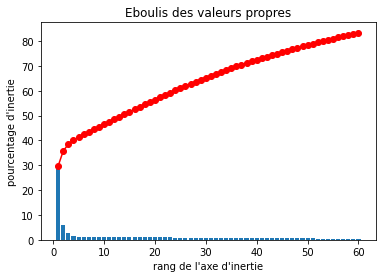

In [24]:
from functions import *
from sklearn.decomposition import PCA

pca = PCA(n_components=60)
pca.fit(X_scaled)
display_scree_plot(pca)

In [25]:
X_scaled = pca.transform(X_scaled)

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import os
from sklearn import metrics
from sklearn import cluster
from sklearn import preprocessing
from sklearn import cluster
from sklearn import preprocessing
import plotly.express as px
import datetime

In [27]:
# Choice of clusters for kmeans
myclust = cluster.KMeans(n_clusters=2)
myclust.fit(X_scaled)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

## Visualisation avec T-SNE en 3D

In [28]:
df_reviews['stars']=[1 if (x>3) else 0 for x in df_reviews['stars']]

In [30]:
# Applying TSNE to scaled data:
from sklearn import manifold
tsne = manifold.TSNE(n_components=2, init='pca')
X_trans = tsne.fit_transform(X_scaled)

In [31]:
# Display results
import plotly.express as px

a = X_trans[:, 0]
b = X_trans[:, 1]
d = myclust.labels_
e = df_reviews['stars'][:100000]

t = pd.DataFrame({'Component1':a,'Component2':b, 'Clusters':d, 'Stars':e})

fig = t.plot.scatter(x="Component1", y="Component2", color='Clusters', title='clustering by clusters', hover_data=['Clusters','Stars'])
fig.show()

fig = t.plot.scatter(x="Component1", y="Component2", color='Stars', title='clustering by labels', hover_data=['Clusters','Stars'])
fig.show()


# Embedding et visualisation des mots en 3D

Embedding est une représentation des mots en se basant sur leur contexte et où les distances en terme de statistiques ont un sens

In [7]:
from gensim.test.utils import datapath
from gensim import utils

Number_of_lines = 300000
class MyCorpus:
    """An iterator that yields sentences (lists of str)."""

    def __iter__(self):
#        corpus_path = datapath('lee_background.cor')

        with open('./data/yelp_academic_dataset_review.json',encoding="utf8") as fl:
            for i, line in enumerate(fl):
                L=json.loads(line)
                yield utils.simple_preprocess(L["text"])
                if i+1 == Number_of_lines :
                    break
            

In [12]:
import gensim.models

sentences = MyCorpus()
model = gensim.models.Word2Vec(sentences=sentences)

## Affichage de l'Embedding

In [13]:
from sklearn.decomposition import IncrementalPCA    # inital reduction
from sklearn.manifold import TSNE                   # final reduction
import numpy as np                                  # array handling


def reduce_dimensions(model):
    num_dimensions = 3  # final num dimensions (2D, 3D, etc)

    # extract the words & their vectors, as numpy arrays
    vectors = np.asarray(model.wv.vectors)
    print (vectors.shape)
    labels = np.asarray(model.wv.index2word)  # fixed-width numpy strings

    # reduce using t-SNE
    tsne = TSNE(n_components=num_dimensions, random_state=0)
    vectors = tsne.fit_transform(vectors)

    x_vals = [v[0] for v in vectors]
    y_vals = [v[1] for v in vectors]
    z_vals = [v[2] for v in vectors]
    return x_vals, y_vals, z_vals, labels


x_vals, y_vals, z_vals, labels = reduce_dimensions(model)

(40010, 100)


In [14]:
def plot_with_plotly(x_vals, y_vals, z_vals, labels, plot_in_notebook=True):
    import plotly.express as px
    
    Delta=pd.DataFrame({'x':x_vals, 'y' :y_vals, 'z' : z_vals})
    fig=px.scatter_3d(data_frame=Delta,x='x', y='y', z='z', text=labels,title='3D Scatter plot for word embedding')
    fig.show()

number_of_words=100
plot_with_plotly(x_vals[:number_of_words], y_vals[:number_of_words], z_vals[:number_of_words], labels[:number_of_words])

## sauvegarde du modele

In [4]:
from gensim.test.utils import common_texts
from gensim.models import Word2Vec

model.save("model_word2vect.model")